In [1]:
using Convex, SCS, Plots, Statistics, LinearAlgebra, Random, MAT, Printf

In [2]:
Random.seed!(1234)

TaskLocalRNG()

In [3]:
vars = matread("data/mnist.mat") # adjust the file path if necessary
testX = vars["testX"]
testY = dropdims(Int.(vars["testY"]), dims=1)   # labels
trainX = vars["trainX"]
trainY = dropdims(Int.(vars["trainY"]), dims=1) # labels
varinfo(Regex(".*X|.*Y"))

"""
Filter out all digits except 4 and 9.
Return these digit images as floats.
"""
function filter_49(X, Y)
    idx = (Y .== 4) .| (Y .== 9)
    return Float64.(X[idx, :]), Float64.(Y[idx])
end

Atrain, btrain = filter_49(trainX, trainY)
Atest, btest = filter_49(testX, testY);

is49(y) = 1.0 * (y .== 4) - 1.0 * (y .== 9)
btrain = is49.(btrain)
btest = is49.(btest);

function debias_and_normalize!(A, μ, σ)
    A .-= μ
    A ./= max.(σ, 1)
end
μtrain = mean(Atrain, dims=1)
σtrain = std(Atrain, dims=1)
debias_and_normalize!(Atrain, μtrain, σtrain);

function C(x, a)
    return sign(dot(x, a))
end

function error_rate(A, b, x)
    m = length(b)
    incorrect = sum(C(x, A[i,:]) != b[i] for i in 1:m)
    return incorrect / m
end

n = 100

# Convert labels to 0 or 1, overwriting the old labels
btrain01 = (btrain .+ 1) ./ 2
btest01 = (btest .+ 1) ./ 2;

Atrain   = Atrain[1:n, 1:n]
btrain01 = btrain01[1:n]
btrain = btrain[1:n]

100-element Vector{Float64}:
  1.0
 -1.0
  1.0
 -1.0
  1.0
 -1.0
  1.0
 -1.0
 -1.0
 -1.0
  ⋮
  1.0
  1.0
 -1.0
 -1.0
 -1.0
 -1.0
 -1.0
  1.0
 -1.0

### Lambda

In [4]:
λ = 1e-1

0.1

In [31]:
n, p = size(Atrain)
size(btrain)

(100,)

In [5]:
n, p = size(Atrain)
x1 = Variable(p)

lrProblem = minimize(logisticloss(-btrain .* (Atrain  * x1)) / n + 0.5 * λ * dot(x1, x1))
solve!(lrProblem, SCS.Optimizer)

println("Optimal value: ", lrProblem.optval)
println("Optimal x: ", x1.value)

┌ Info: [Convex.jl] Compilation finished: 2.28 seconds, 512.894 MiB of memory allocated
└ @ Convex /Users/junhyun/.julia/packages/Convex/8Dpiy/src/solution.jl:107


------------------------------------------------------------------
	       SCS v3.2.7 - Splitting Conic Solver
	(c) Brendan O'Donoghue, Stanford University, 2012
------------------------------------------------------------------
problem:  variables n: 500, constraints m: 1000
cones: 	  l: linear vars: 100
	  q: soc vars: 300, qsize: 100
	  e: exp vars: 600, dual exp vars: 0
settings: eps_abs: 1.0e-04, eps_rel: 1.0e-04, eps_infeas: 1.0e-07
	  alpha: 1.50, scale: 1.00e-01, adaptive_scale: 1
	  max_iters: 100000, normalize: 1, rho_x: 1.00e-06
	  acceleration_lookback: 10, acceleration_interval: 10
	  compiled with openmp parallelization enabled
lin-sys:  sparse-direct-amd-qdldl
	  nnz(A): 3200, nnz(P): 0
------------------------------------------------------------------
 iter | pri res | dua res |   gap   |   obj   |  scale  | time (s)
------------------------------------------------------------------
     0| 1.06e+00  1.26e-01  2.24e+01  6.13e+00  1.00e-01  4.08e-03 
   125| 7.25e-08  2.

In [28]:
sizeof(Atrain)

80000

In [6]:
function compute_condition_number(A)
    S = svd(A)
    max = maximum(S.S)
    min = minimum(S.S)
    κ = (max^2 + λ) / (min^2 + λ)
    return κ
end

compute_condition_number(Atrain)

11.501373472119333

In [7]:
btrain = btrain01

100-element Vector{Float64}:
 1.0
 0.0
 1.0
 0.0
 1.0
 0.0
 1.0
 0.0
 0.0
 0.0
 ⋮
 1.0
 1.0
 0.0
 0.0
 0.0
 0.0
 0.0
 1.0
 0.0

$f(w) = \frac{1}{n}\sum_{i=1}^{n} \log\left(1 + \exp(-b_i a_i^\top w)\right) + \frac{\lambda}{2} \|w\|^2$

In [8]:
σ(z) = 1 / (1 + exp(-z))

"""
Loss function. Note that we use `min` and `max` to avoid taking the log of zero or one.
"""
function f(x) 
   z = σ.(Atrain * x)
   zadj = min.(max.(z, eps()), 1-eps())
   return sum(-btrain .* log.(zadj) - (1.0 .- btrain) .* log.(1.0 .- zadj)) / n + 0.5 * λ * dot(x, x)
end

"Loss gradient"
function ∇f(x, A, b; n=100)
    z = σ.(A*x)
    zadj = min.(max.(z, eps()), 1-eps())
    return A' * (zadj - b) / n + λ * x
end

∇f

In [9]:
# σ(z) = 1 / (1 + exp(-z))

# """
# Logistic loss function for labels in {-1, +1}
# """
# function f(x)
#     z = Atrain * x                      # linear prediction
#     yz = -btrain .* z                   # margin: -bᵢ * (aᵢᵗ x)
#     loss = sum(log.(1 .+ exp.(yz))) / n
#     return loss + 0.5 * λ * dot(x, x)   # L2 regularization
# end

# """
# Gradient for logistic loss with labels in {-1, +1}
# """
# function ∇f(x, A, b; n=100)
#     z = A * x
#     yz = -b .* z                        # margin
#     s = σ.(yz)                          # sigmoid(-bᵢ xᵢᵗ x)
#     grad = A' * (-b .* s) / n
#     return grad + λ * x
# end


In [10]:
struct ErrorRateTrace
    train::Vector{Float64}
    test::Vector{Float64}
    loss::Vector{Float64}
    variance::Vector{Float64}
end

ErrorRateTrace() = ErrorRateTrace([], [], [], [])

ErrorRateTrace

In [11]:
function beststeps_top5(d)
    results = Float64[]
    stepsizes = Float64[]

    for c in 10.0:-0.025:0.025
        x0 = zeros(size(Atrain, 2))

        x1, _ = d(∇f, x0, Atrain, btrain, c, max_iters=1)

        if f(x1) > f(x0)
            continue
        end

        x0 = zeros(size(Atrain, 2))
        x, _ = d(∇f, x0, Atrain, btrain, c, max_iters=10)
        loss = abs(f(x))


        if isnan(loss)
            loss = Inf
        end
        push!(stepsizes, c)
        push!(results, loss)
    end

    sorted_indices = sortperm(results)
    return stepsizes[sorted_indices[1:5]]
end

beststeps_top5 (generic function with 1 method)

In [12]:
function final_result(∇f, x, A, b, trace)
    final_grad = ∇f(x, A, b)
    n_train = size(A, 1)    
    println("Final gradient norm: ", norm(final_grad))
    println("Final Loss: ", trace.loss[end])
end

final_result (generic function with 1 method)

### Gradient Descent

In [13]:
function gd(∇f, x, A, b, α; tol=1e-15, max_iters=10_000)
    trace = ErrorRateTrace()
    update!(trace, x)
    
    for k in 1:max_iters
        d = ∇f(x, A, b)
        x = x - α * d
        
        update!(trace, x)

        if abs(f(x) - f(x1.value)) < tol
            break
        end
    end
    return x, trace
end

gd (generic function with 1 method)

### SGD

In [14]:
function sgd(∇f, x, A, b, c; batch_size=1, tol=1e-15, max_iters=iter) 
    trace = ErrorRateTrace()

    n = size(A, 1)

    iter = Int(max_iters * n * 3 / batch_size)

    update!(trace, x)

    for k in 1:iter
        batch = randperm(n)[1:batch_size]
        A_batch = A[batch, :]
        b_batch = b[batch]

        # α = c 
        # α = c / sqrt(k)
        α = c / (1 + 0.01 * k) 


        g = ∇f(x, A_batch, b_batch, n=batch_size)

        x = x - α * g

        if k % Int(n / batch_size) == 0
            update!(trace, x)
            
            if abs(f(x) - f(x1.value)) < tol
                break
            end
        end
        
    end
    return x, trace
end

sgd (generic function with 1 method)

### Stochastic Variance Reduced Gradient

In [15]:
function svrg(∇f, x, A, b, α; batch_size=1, max_iters=10, inner_iter=2*size(Atrain, 1), option="I", tol=1e-15)
    trace = ErrorRateTrace()
    n = size(A, 1)

    # x0 = zeros(size(Atrain, 2))
    # x, _ = sgd(∇f, x0, Atrain, btrain, 0.25, max_iters=1)

    update!(trace, x)

    for j in 1:max_iters
        x_t = copy(x)
        μ = ∇f(x_t, A, b)
        update!(trace, x)

        if abs(f(x) - f(x1.value)) < tol
            break
        end

        w_history = Vector{typeof(x)}()

        push!(w_history, copy(x))

        for k in 1:inner_iter
            batch = randperm(n)[1:batch_size] 
            A_batch = A[batch, :]
            b_batch = b[batch]

            g = ∇f(x, A_batch, b_batch)
            g_t = ∇f(x_t, A_batch, b_batch)

            x = x - α * (g - g_t + μ)

            push!(w_history, copy(x)) 

            if k % n == 0
                update!(trace, x)
                if abs(f(x) - f(x1.value)) < tol
                    break
                end
            end
        end 
    
        if option == "I"
            x = copy(w_history[end])
        elseif option == "II"
            x = copy(w_history[rand(1:inner_iter)])
        end
    end     

    return x, trace
end

svrg (generic function with 1 method)

### Test

In [16]:
iter = 100_000

100000

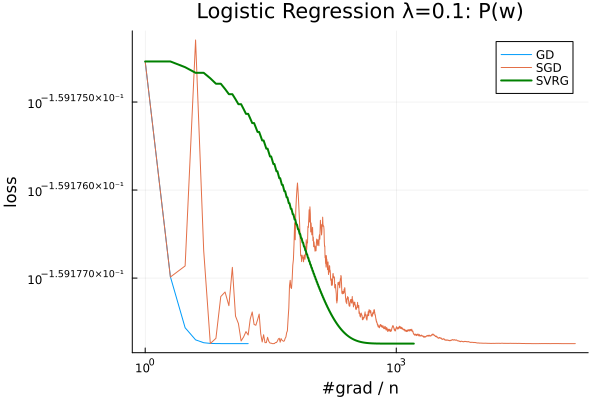

In [17]:
Random.seed!(123)

function update!(t::ErrorRateTrace, x)
    push!(t.loss, f(x))
end

x = zeros(size(Atrain, 2))
xgd, trace_gd = gd(∇f, x, Atrain, btrain, 5, max_iters=3*iter)
xsgd, trace_sgd = sgd(∇f, x, Atrain, btrain, 0.043, batch_size=1, max_iters=iter)
xsvrg, trace_svrg = svrg(∇f, x, Atrain, btrain, 0.001, max_iters=iter)

p0 = plot(xscale=:log10, yscale=:log10, xlabel="#grad / n", ylabel="loss", title="Logistic Regression λ=0.1: P(w)", legend=:topright)

plot!(p0, trace_gd.loss, label="GD")
plot!(p0, trace_sgd.loss, label="SGD")
plot!(p0, trace_svrg.loss, label="SVRG", linewidth = 2, color = :green)

plot!(p0, linewidth=2, grid=true)

display(p0)

In [18]:
# p0 = plot(xscale=:log10, yscale=:log10, xlabel="#grad / n", ylabel="loss", title="Logistic Regression λ=0.1: P(w)", legend=:topright)

# plot!(p0, trace_gd.loss, label="GD")
# plot!(p0, trace_sgd.loss, label="SGD")
# plot!(p0, trace_svrg.loss, label="SVRG", linewidth = 2, color = :green)

# plot!(p0, linewidth=2, grid=true)

# display(p0)

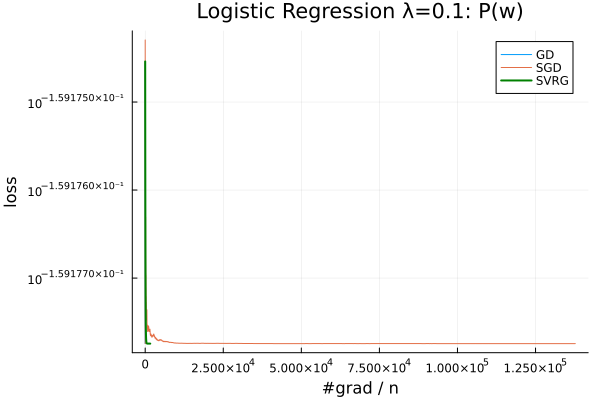

In [19]:
p1 = plot(yscale=:log10, xlabel="#grad / n", ylabel="loss", title="Logistic Regression λ=0.1: P(w)", legend=:topright)

plot!(p1, trace_gd.loss, label="GD")
plot!(p1, trace_sgd.loss, label="SGD")
plot!(p1, trace_svrg.loss, label="SVRG", linewidth = 2, color = :green)

plot!(p1, linewidth=2, grid=true)

display(p1)

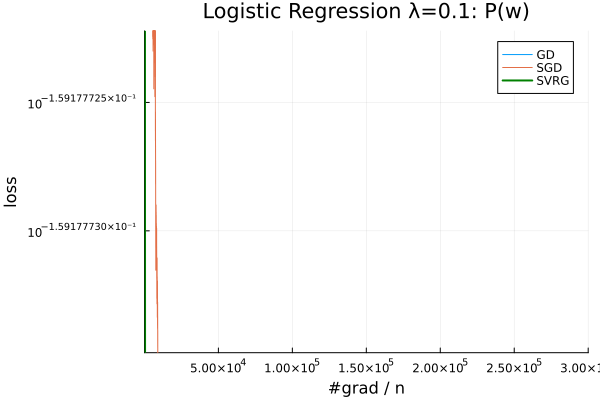

In [20]:
p2 = plot(yscale=:log10, xlabel="#grad / n", ylabel="loss", title="Logistic Regression λ=0.1: P(w)", legend=:topright)

plot!(p2, trace_gd.loss, label="GD")
plot!(p2, trace_sgd.loss, label="SGD")
plot!(p2, trace_svrg.loss, label="SVRG", linewidth = 2, color = :green)

plot!(p2, linewidth=2, grid=true)

xlims!(p2, 80, 300_000)
ylims!(p2, 0.69314208, 0.6931421)

display(p2)

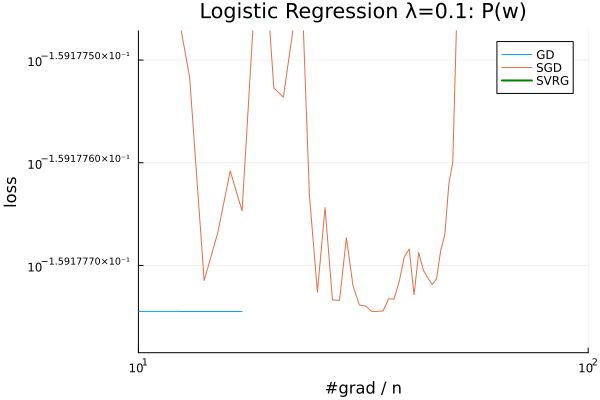

In [21]:
p3 = plot(xscale=:log10, yscale=:log10, xlabel="#grad / n", ylabel="loss", title="Logistic Regression λ=0.1: P(w)", legend=:topright)

plot!(p3, trace_gd.loss, label="GD")
plot!(p3, trace_sgd.loss, label="SGD")
plot!(p3, trace_svrg.loss, label="SVRG", linewidth = 2, color = :green)

plot!(p3, linewidth=2, grid=true)

xlims!(p3, 10, 100)
ylims!(p3, 0.6931420, 0.6931425)

display(p3)

In [22]:
Random.seed!(123)

function update!(t::ErrorRateTrace, x)
    push!(t.loss, max.(f(x)-f(x1.value), eps()))
    # push!(t.loss, f(x))
end
x = zeros(size(Atrain, 2))
xgdr, trace_gdr = gd(∇f, x, Atrain, btrain, 5, max_iters=3*iter)
xsgdr, trace_sgdr = sgd(∇f, x, Atrain, btrain, 0.043, batch_size=1, max_iters=iter)
xsvrgr, trace_svrgr = svrg(∇f, x, Atrain, btrain, 0.001, max_iters=iter)

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0002561826095107379, 0.0009217352891597784, 0.0012241684025991522, 0.0022919396836435244, 0.002628588882551334, 0.0032285224279774566, 0.003028680106010463, 0.003292194006031979, 0.003935350731605443, 0.0045462886700674944], ErrorRateTrace(Float64[], Float64[], [5.116364602875123e-6, 5.116364602875123e-6, 5.012402675697025e-6, 4.910526726131792e-6, 4.910526726131792e-6, 4.810747320282971e-6, 4.712969969955516e-6, 4.712969969955516e-6, 4.617204816481646e-6, 4.523361173736085e-6  …  1.3322676295501878e-15, 1.2212453270876722e-15, 1.4432899320127035e-15, 1.4432899320127035e-15, 1.4432899320127035e-15, 1.1102230246251565e-15, 1.1102230246251565e-15, 1.1102230246251565e-15, 8.881784197001252e-16, 8.881784197001252e-16], Float64[]))

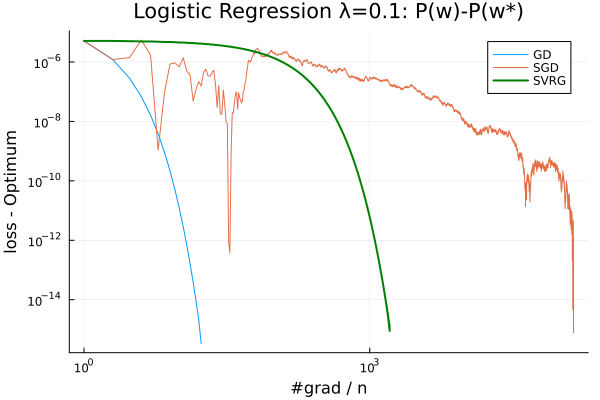

In [23]:
pr0 = plot(xscale=:log10, yscale=:log10, xlabel="#grad / n", ylabel="loss - Optimum", title="Logistic Regression λ=0.1: P(w)-P(w*)", legend=:topright)

plot!(pr0, trace_gdr.loss, label="GD")
plot!(pr0, trace_sgdr.loss, label="SGD")
plot!(pr0, trace_svrgr.loss, label="SVRG", linewidth = 2, color = :green)

plot!(pr0, linewidth=2, grid=true)

display(pr0)

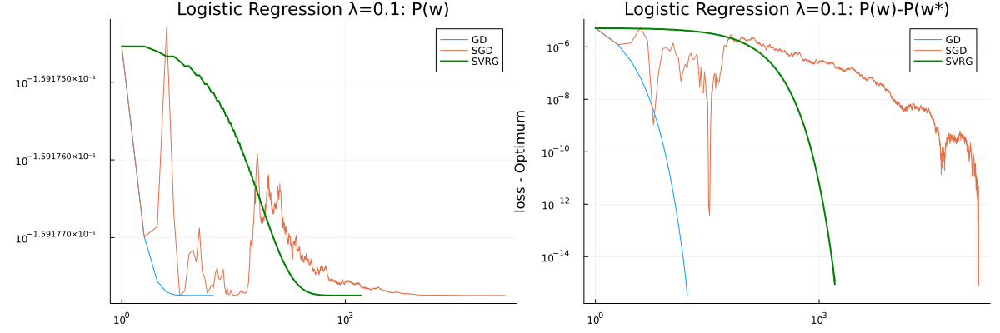

In [26]:
plot(p0, pr0, layout=(1, 2), size=(1200, 400))